# Springback UV map

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams['figure.dpi'] = 120

from cut_predictor import ProjectionPredictor

In [16]:
doe = pd.read_csv('../data/doe.csv')
doe.describe()

,doe_id,Material_ID,Blechdicke,Niederhalterkraft,Ziehspalt,Stempel_ID,Einlegeposition,Ziehtiefe,Breite,UG,OG,E,Rp0,Rp0.2,Rp100,Rp25,Rp50
count,1000.000000,1000.000000,1000.000000,1000.00000,1000.00000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,500.500000,3.866000,1.188370,251.12000,2.17280,2.716000,-0.422000,45.000000,70.65440,1.548120,1.809720,129.102675,209.942033,217.051735,481.885749,401.776216,442.422026
std,288.819436,1.637292,0.224187,147.00325,0.36093,0.451162,3.326708,16.591422,0.72186,0.257163,0.302279,58.332400,56.832894,54.073664,112.525169,61.073415,80.305188
min,1.000000,1.000000,0.990000,10.00000,1.60000,2.000000,-5.000000,30.000000,70.20000,1.140000,1.330000,71.681980,133.182632,147.101263,384.123147,369.820589,383.041834
25%,250.750000,3.000000,1.000000,120.00000,1.60000,2.000000,-3.250000,30.000000,70.20000,1.140000,1.330000,71.681980,138.226960,147.601859,384.123147,369.820589,383.041834
50%,500.500000,4.000000,1.010000,250.00000,2.40000,3.000000,-0.500000,40.000000,70.20000,1.710000,2.000000,118.282190,235.160326,237.951493,451.324586,374.608673,415.842304
75%,750.250000,5.000000,1.480000,380.00000,2.40000,3.000000,2.000000,55.000000,71.80000,1.710000,2.000000,191.372450,248.796491,251.315902,534.002871,385.773439,449.528189
max,1000.000000,6.000000,1.480000,500.00000,2.40000,3.000000,5.000000,70.000000,71.80000,1.710000,2.000000,200.038130,296.556500,306.211480,711.700600,556.006850,629.530400


In [3]:
data = pd.read_csv('../data/springback_uvmap.csv')
data.drop(data[data.doe_id == 1000].index, inplace=True)
data.drop(data[data.doe_id == 247].index, inplace=True)
data

,doe_id,u,v,x,y,z,thickness,epseqpl,thinning
0,1,0.000000,0.000000,-132.603620,-117.544130,0.895656,1.000417,0.000823,0.990512
1,1,0.500000,0.019171,-0.000088,-87.060616,0.489975,0.991176,0.010210,0.981363
2,1,1.000000,0.036529,137.002380,-104.238950,0.742256,1.000619,0.001208,0.990712
3,1,1.000000,0.000000,132.603620,-117.544130,0.895656,1.000417,0.000823,0.990512
4,1,0.500000,0.000000,-0.000141,-95.070107,0.536487,0.992336,0.007779,0.982511
...,...,...,...,...,...,...,...,...,...
16721570,998,0.254233,0.654230,-89.967537,28.110500,35.537619,1.354696,0.277900,0.915335
16721571,998,0.255316,0.641760,-89.548157,28.170677,37.664772,1.345915,0.279300,0.909402
16721572,998,0.255497,0.628215,-89.451439,28.237469,39.968052,1.340451,0.279300,0.905710
16721573,998,0.254664,0.617541,-89.724800,28.299198,41.775429,1.393057,0.217900,0.941255


In [4]:
reg = ProjectionPredictor()
reg.load_data(
    doe = doe,
    data = data,
    index='doe_id',
    process_parameters = [
        'Blechdicke', 
        'Niederhalterkraft', 
        'Ziehspalt', 
        'Einlegeposition', 
        'Ziehtiefe',
        'Stempel_ID',
    ],
    categorical = [
        'Ziehspalt', 
        'Ziehtiefe',
        'Stempel_ID',
    ],
    position = ['u', 'v'],
    output = ['x', 'y', 'z'] #, 'thickness', 'epseqpl', 'thinning']
    validation_split=0.1,
    validation_method='leaveoneout'
)

In [5]:
reg.data_summary()

Data summary
------------------------------------------------------------

Process parameters:
	- Blechdicke : numerical [ 0.99  ...  1.48 ]
	- Niederhalterkraft : numerical [ 10  ...  500 ]
	- Ziehspalt : categorical [1.6, 2.4]
	- Einlegeposition : numerical [ -5  ...  5 ]
	- Ziehtiefe : categorical [30, 50, 70]
	- Stempel_ID : categorical [2, 3]
Input variables:
	- u : numerical, [ 0.0 / 1.0 ] 
	- v : numerical, [ 0.0 / 1.0 ] 
Output variable(s):
	- x : numerical, [ -202.42731 / 202.42731 ]
	- y : numerical, [ -118.32256 / 96.918961 ]
	- z : numerical, [ 0.0 / 73.213165 ]

Inputs (16697652, 12)
Outputs (16697652, 3)
Total number of samples: 16697652
Number of training samples: 15027886
Number of test samples: 1669766


Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               3328      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 256)               0         
                                                                 
 dense_1 (Dense)             (None, 256)               65792     
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 256)               0         
                                                                 
 dense_2 (Dense)             (None, 256)               65792     
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 256)               0         
                                         

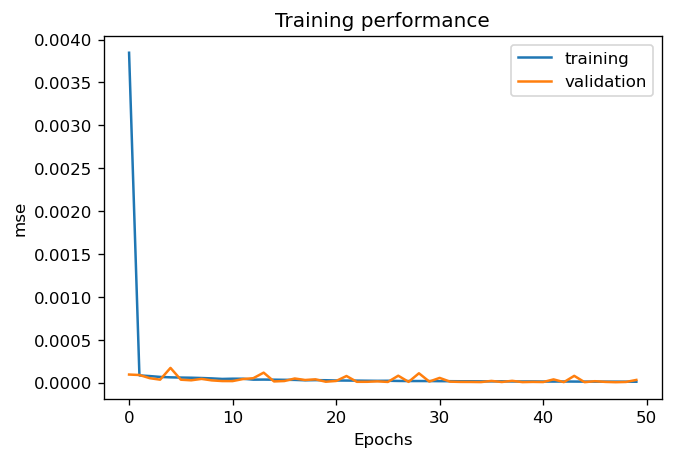

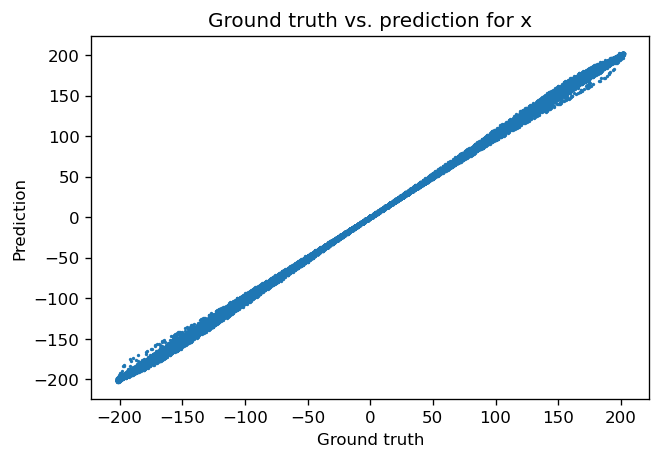

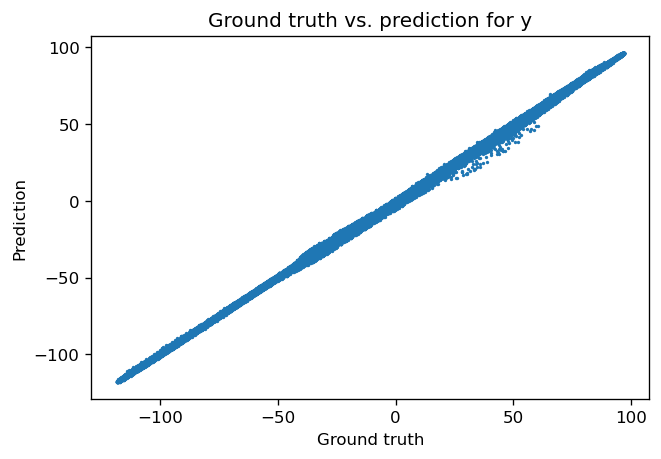

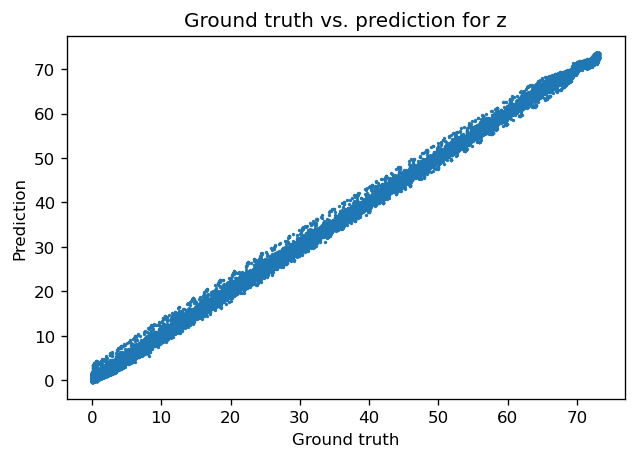

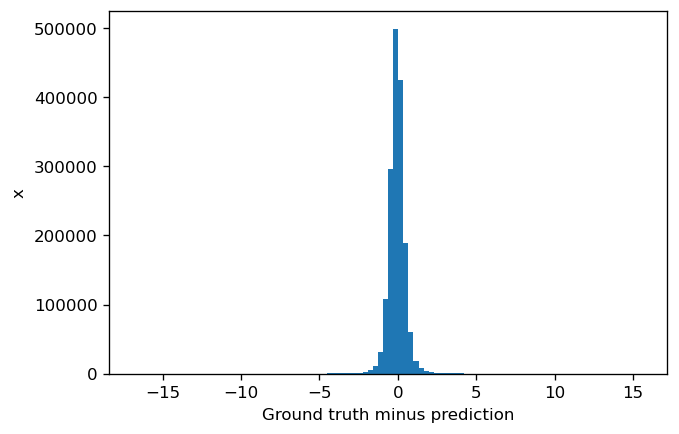

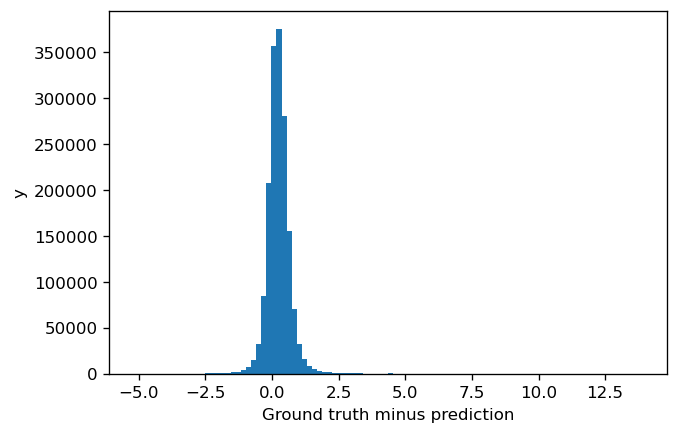

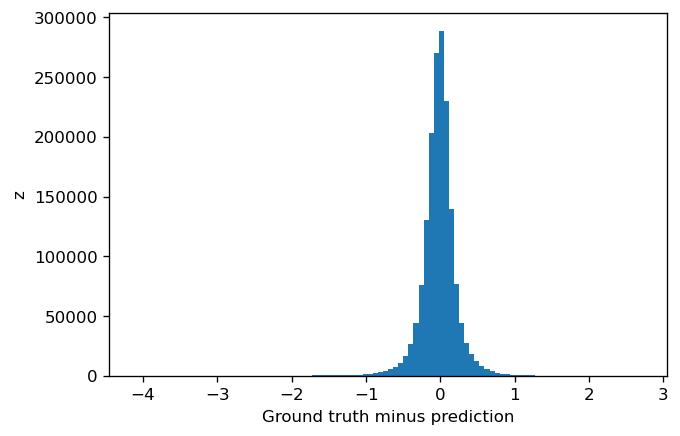

In [6]:
config = {
    'batch_size': 2048*16,
    'max_epochs': 50,
    'layers': [256, 256, 256, 256, 256],
    'dropout': 0.0,
    'learning_rate': 0.001,
    'activation': 'lrelu'
}

reg.custom_model(save_path='models/best_uv_model', config=config, verbose=True)
reg.training_summary()

In [6]:
reg.load_network('models/best_uv_model')

Metal device set to: Apple M1 Pro

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



Doe_ID 464


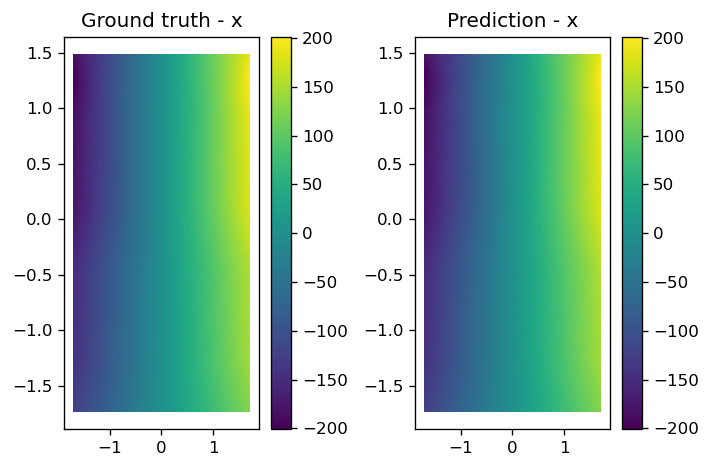

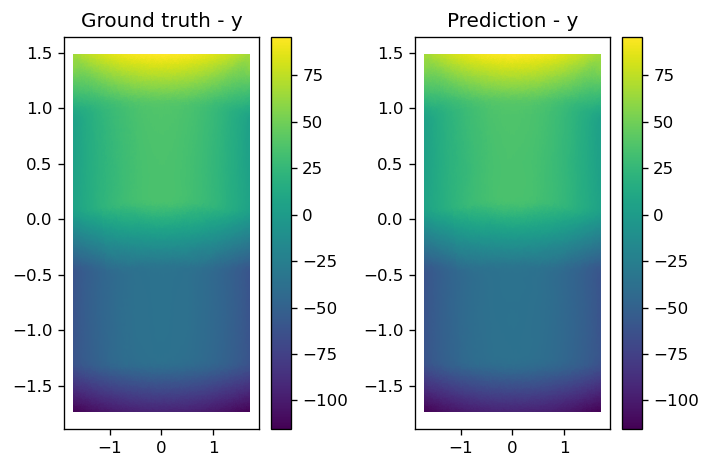

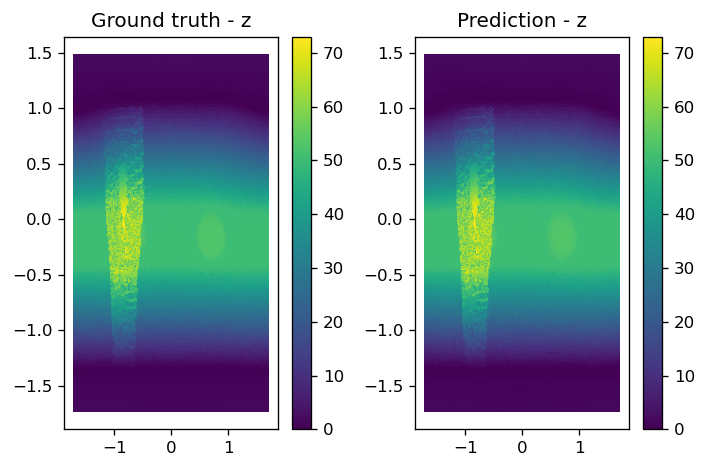

In [7]:
idx = np.random.choice(data['doe_id'].unique()) 
print("Doe_ID", idx)
reg.compare(idx)

In [8]:
x, y = reg.predict({
        'Blechdicke': 1.01, 
        'Niederhalterkraft': 410.0, 
        'Ziehspalt': 2.4, 
        'Einlegeposition': -5, 
        'Ziehtiefe': 30,
        'Stempel_ID': 3,
        'E': 191.37245,
        'Rp0': 138.22696,
        'Rp50': 449.528189,
    }, 
    shape=(500, 500))

import plotly
import plotly.graph_objs as go
plotly.offline.init_notebook_mode()

def show_surface(x, y):
    # Configure the trace.
    trace = go.Scatter3d(
        x=y[0, :, :].flatten(),  
        y=y[1, :, :].flatten(),
        z=y[2, :, :].flatten(),
        mode='markers',
        marker={
            'size': 0.2,
            'opacity': 0.8,
        }
    )

    # Configure the layout.
    layout = go.Layout(
        margin={'l': 0, 'r': 0, 'b': 0, 't': 0}
    )

    data = [trace]

    plot_figure = go.Figure(data=data, layout=layout)

    # Render the plot.
    plotly.offline.iplot(plot_figure)

show_surface(x, y)


In [15]:
%matplotlib inline
plt.rcParams['figure.dpi'] = 150

def mpl_show_surface(x, y):

    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    p = ax.scatter(
        y[0, :, :].flatten(),  
        y[1, :, :].flatten(),
        y[2, :, :].flatten(),
        s=0.01
    )

reg.interactive(mpl_show_surface, positions=(200, 200))

interactive(children=(FloatSlider(value=1.1883700000000001, description='Blechdicke', max=1.48, min=0.99, step…